In [64]:
import torch
import torch.nn as nn
from torchvision import datasets
from torch.utils.data import DataLoader, Dataset
from torch.optim import Adam
from torchvision.transforms import ToTensor, Compose, Resize
from matplotlib import pyplot as plt

from PIL import Image

In [65]:
if torch.cuda.is_available():
    device=torch.device(type='cuda',index=0)
else:
    device=torch.device(type='cpu',index=0)

In [66]:
import os
dl = []
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        dl+=[os.path.join(dirname, filename)]
dl = dl[1:]

In [67]:
dl = dl[:-4]

In [68]:
class Animal10(Dataset):
    def __init__(self, input_list):
        self.transform = Compose([
            Resize((32,32),Image.BILINEAR), 
            ToTensor(),
        ])
        self.iml = input_list    
        self.translate = {"cane":0, "cavallo": 1, "elefante": 2, "farfalla":3, "gallina": 4, "gatto":5, "mucca":6, "pecora":7, "scoiattolo": 8, "ragno" : 9}
        
    def __len__(self):
        return len(self.iml)
        
    def __getitem__(self, idx):
        imp = self.iml[idx]
        img = Image.open(imp).convert('RGB')
        parts = imp.split('/')
        extracted_part = parts[-2]
        return self.transform(img),self.translate[extracted_part]
        

In [69]:
batch_size=4096

trainDS = Animal10(dl)
train_dataloader=DataLoader(dataset=trainDS, batch_size=batch_size, shuffle=True)
eval_dataloader=DataLoader(dataset=trainDS, batch_size=batch_size, shuffle=True)

In [71]:
class Encoder1(nn.Module):
    def __init__(self):
        super().__init__()
        self.lkrelu=nn.LeakyReLU(0.1)
        self.l1=nn.Linear(in_features=1024,out_features=512)
        self.l2=nn.Linear(in_features=512,out_features=256)
    
    def forward(self,x):
        net1=self.l1(x)
        out1=self.lkrelu(net1)
        net2=self.l2(out1)
        out2=self.lkrelu(net2)
        return out2

class Encoder2(nn.Module):
    def __init__(self):
        super().__init__()
        self.lkrelu=nn.LeakyReLU(0.1)
        self.l1=nn.Linear(in_features=256,out_features=100)
            
    def forward(self,x):
        net1=self.l1(x)
        out1=self.lkrelu(net1)
        return out1

In [72]:
lossmse_fn=nn.MSELoss()
lossentropy_fn=nn.CrossEntropyLoss()
lr = 0.0002

e1=Encoder1().to(device)
e2=Encoder2().to(device)

opte1=Adam(params=e1.parameters(),lr=lr)
opte2=Adam(params=e2.parameters(),lr=lr)

e1.load_state_dict(torch.load('/kaggle/input/autoencoder_animal10/pytorch/25epochs_noclf/1/3encoder1.pth'))
e2.load_state_dict(torch.load('/kaggle/input/autoencoder_animal10/pytorch/25epochs_noclf/1/3encoder2.pth'))

<All keys matched successfully>

In [23]:
def get_latent():
    e1.eval()
    e2.eval()
    
    with torch.no_grad():
        for i,(x,_) in enumerate(eval_dataloader):
            x=torch.reshape(x,shape=(-1,1024))
            x=x.to(device)

            latente1=e1(x)
            latente2=e2(latente1)
            
            break;
    
    return x, latente2

Latent tensor([ 3.4104e-01,  1.1550e+00,  5.9343e-01,  4.8719e-01,  9.7199e-01,
         2.2570e-01,  1.4336e+00,  1.2308e-01,  1.3416e+00,  3.2435e-01,
        -3.9753e-02,  4.1381e-01,  4.8534e-01, -1.3131e-01, -6.1893e-03,
         2.9457e-01, -8.7297e-02,  1.7495e-01, -9.3744e-02, -1.0989e-01,
         1.3638e+00,  1.1902e+00, -1.9557e-02,  7.6180e-01, -3.9043e-04,
         6.9552e-02,  2.3704e+00,  6.4912e-01,  1.3693e+00, -7.4256e-04,
         7.5144e-01,  5.5409e-01,  6.8924e-01,  7.6446e-01,  6.5949e-01,
        -5.3854e-02,  1.3758e+00,  1.3715e+00,  1.2965e+00,  7.3907e-01,
         8.1025e-01,  2.7183e-01, -6.8998e-02,  2.3623e+00,  2.4624e-01,
        -7.9861e-03,  1.0272e+00,  1.0136e+00,  1.1934e+00,  3.4824e-01,
        -2.1412e-02, -7.0739e-02,  7.9972e-01,  1.5265e+00, -1.3254e-01,
         1.7683e+00, -1.9958e-02,  5.8278e-01,  6.1561e-01,  3.2145e-02,
         7.2749e-01,  9.3625e-01,  7.3429e-01,  1.1692e+00,  4.7170e-01,
        -9.2340e-03, -8.6408e-02,  1.1951e+0

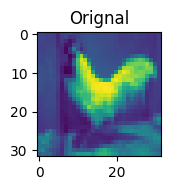

In [24]:
x, latent = get_latent()

plt.figure(figsize=(1.6,2.4))

r=torch.randint(low=0,high=latent.shape[0],size=(1,)).item()

plt.title("Orignal")
plt.imshow(torch.reshape(x[r],shape=(32,32)).cpu())

print("Latent", latent[r])


In [77]:
class Generator(nn.Module):
    def __init__(self,latent_dim, img_size):
        super().__init__()
        self.latent_dim=latent_dim
        self.img_size=img_size
        self.init_size=self.img_size//8
        
        self.lin=nn.Linear(
            in_features=self.latent_dim,
            out_features=128*self.init_size*self.init_size 
        )
        
        self.tconv_part=nn.Sequential(
            nn.ConvTranspose2d(128,64,4,2,1),
            nn.BatchNorm2d(num_features=64),
            nn.ReLU(),
            nn.Dropout2d(0.25),
            
            nn.ConvTranspose2d(64,32,4,2,1),
            nn.BatchNorm2d(num_features=32),
            nn.ReLU(),
            nn.Dropout2d(0.25),
            
            nn.ConvTranspose2d(32,16,4,2,1),
            nn.BatchNorm2d(num_features=16),
            nn.ReLU(),
            nn.Dropout2d(0.25)
        )
        
        self.convtanh=nn.Sequential(
            nn.Conv2d(16,3,3,1,1),
            nn.Tanh()
        )
        
        
    def forward(self,x):
        
        x=self.lin(x)
        x=x.view(x.shape[0],128,self.init_size,self.init_size)
        x=self.tconv_part(x)
        x=self.convtanh(x)
        
        return x
        
class Discriminator(nn.Module):
    def __init__(self, img_size):
        super().__init__()
        
        self.img_size=img_size
        
        self.conv_part=nn.Sequential(
            nn.Conv2d(3,16,4,2,1),
            nn.BatchNorm2d(num_features=16),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(16,32,4,2,1),
            nn.BatchNorm2d(num_features=32),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(32,64,4,2,1),
            nn.BatchNorm2d(num_features=64),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(64,128,4,2,1),
            nn.BatchNorm2d(num_features=128),
            nn.LeakyReLU(0.2)
        )
        
        self.out=nn.Sequential(
            nn.Linear(128*(self.img_size//(2**(4-1))),
                      2
                     )
        )
        
    def forward(self,x):
        x=self.conv_part(x)
        x=x.view(x.shape[0],-1)
        pred=self.out(x)
        return pred

In [78]:
loss_fn=nn.CrossEntropyLoss().to(device)
n_epochs=50
lr=0.0002

generator=Generator(300,32).to(device)
discriminator=Discriminator(32).to(device)

gopt=Adam(params=generator.parameters(),lr=lr)
dopt=Adam(params=discriminator.parameters(),lr=lr)

In [79]:
def train_one_epoch(plt):
    e1.eval()
    e2.eval()
    for i,(imgs,_) in enumerate(train_dataloader):
        
        print(imgs.shape[0])
    
        x=torch.reshape(imgs,shape=(-1,1024))
        x=x.to(device)

        latente1=e1(x)
        latente2=e2(latente1)
                    
        noise_vectors = latente2.detach().view(imgs.shape[0], 300)

        zero_labels=torch.zeros((imgs.shape[0])).to(device).type(torch.int64)
        one_labels=torch.ones((imgs.shape[0])).to(device).type(torch.int64)
                
        fake_images=generator(noise_vectors)
        
        pred=discriminator(fake_images)
        
        gloss=loss_fn(pred,one_labels)
        
        gopt.zero_grad()
        gloss.backward()
        gopt.step()
        
        
        real_imgs=imgs.to(device)
        
        pred_on_real=discriminator(real_imgs)
        dloss_on_real=loss_fn(pred_on_real,one_labels)
        pred_on_fake=discriminator(fake_images.detach())
        dloss_on_fake=loss_fn(pred_on_fake,zero_labels)
        dloss=(dloss_on_real+dloss_on_fake)/2
        
        dopt.zero_grad()
        dloss.backward()
        dopt.step()
        
        if i%1 == 0:
            
            print("Batch No.:", i+1,"/",len(train_dataloader),":", "GLoss=",round(gloss.item(),4), "DLoss=",round(dloss.item(),4))
            for j in range(64):
                plt.subplot(8,8,j+1)
                plt.imshow(torch.permute(fake_images[j],(1,2,0)).detach().cpu(),interpolation='nearest', cmap='gray_r')
            
            plt.show()
            

Epoch 1 / 5 :
4096
Batch No.: 1 / 7 : GLoss= 0.6391 DLoss= 0.7818


/tmp/ipykernel_34/37407091.py:46: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8,8,j+1)


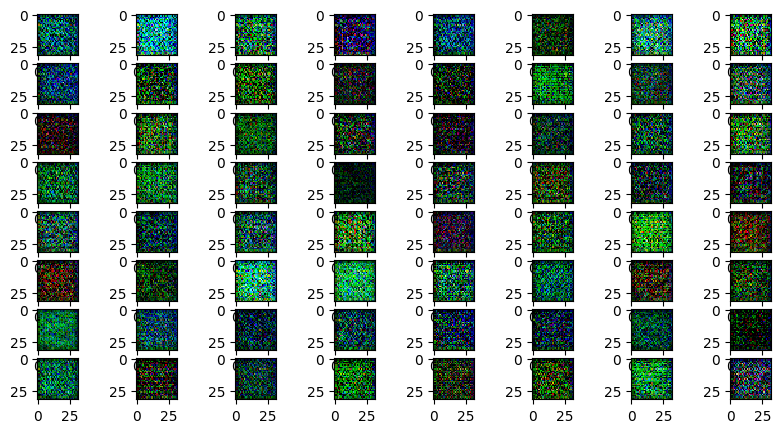

4096
Batch No.: 2 / 7 : GLoss= 0.4106 DLoss= 0.9311


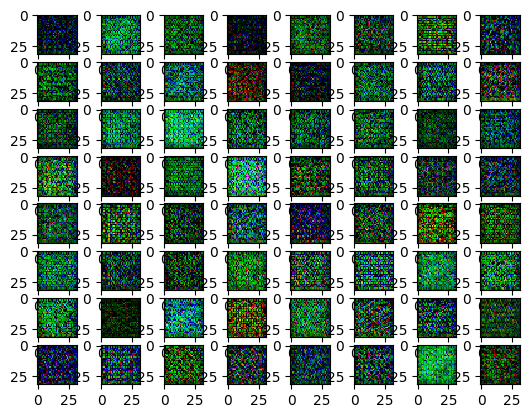

4096
Batch No.: 3 / 7 : GLoss= 0.3365 DLoss= 0.9988


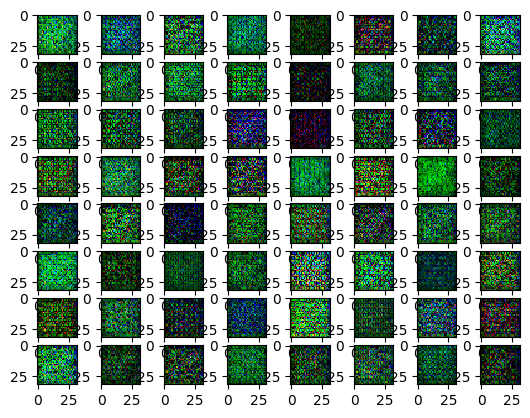

4096
Batch No.: 4 / 7 : GLoss= 0.3379 DLoss= 0.9871


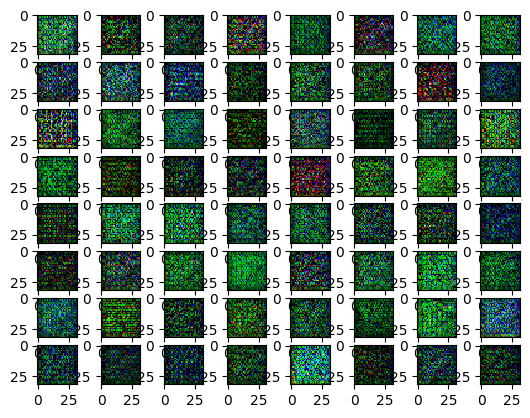

4096
Batch No.: 5 / 7 : GLoss= 0.3817 DLoss= 0.9261


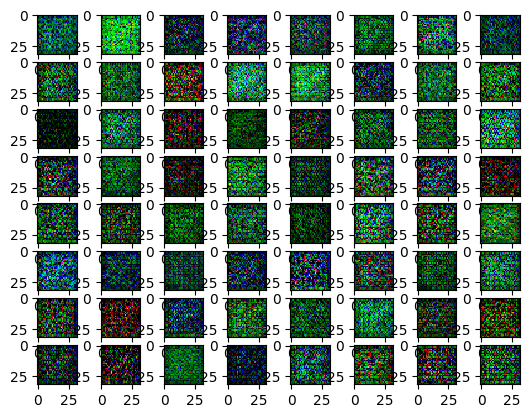

4096
Batch No.: 6 / 7 : GLoss= 0.4524 DLoss= 0.8465


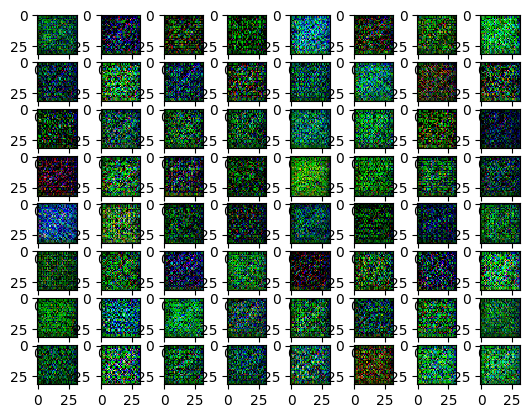

1603
Batch No.: 7 / 7 : GLoss= 0.5209 DLoss= 0.7883


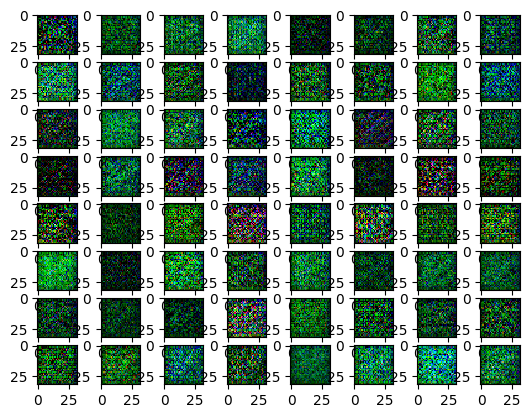

Epoch 2 / 5 :
4096
Batch No.: 1 / 7 : GLoss= 0.5822 DLoss= 0.7408


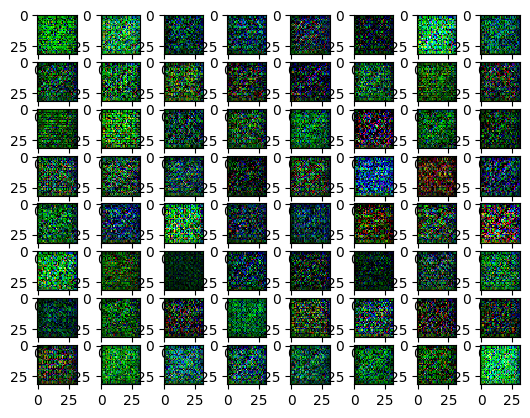

4096
Batch No.: 2 / 7 : GLoss= 0.632 DLoss= 0.7022


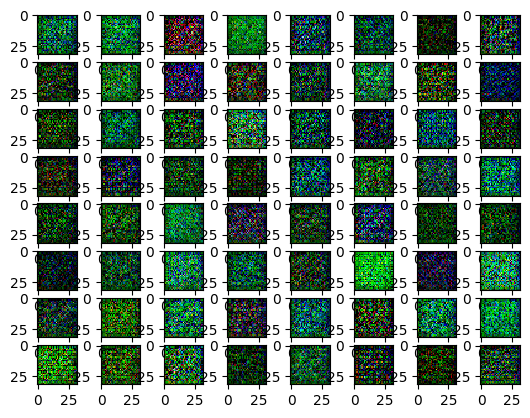

4096
Batch No.: 3 / 7 : GLoss= 0.6461 DLoss= 0.6907


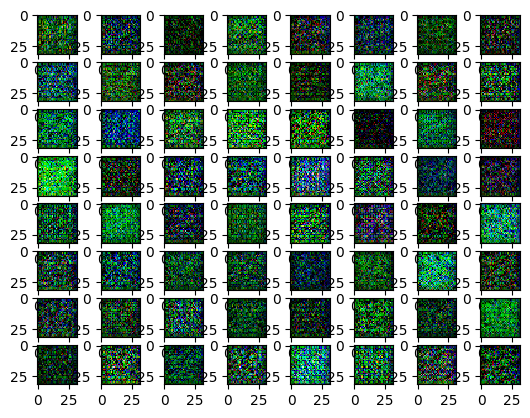

4096
Batch No.: 4 / 7 : GLoss= 0.6636 DLoss= 0.6772


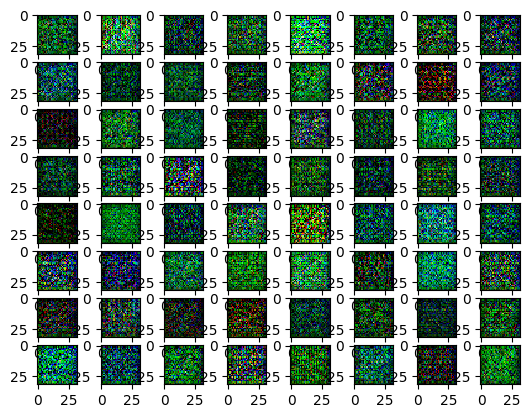

4096
Batch No.: 5 / 7 : GLoss= 0.6569 DLoss= 0.6749


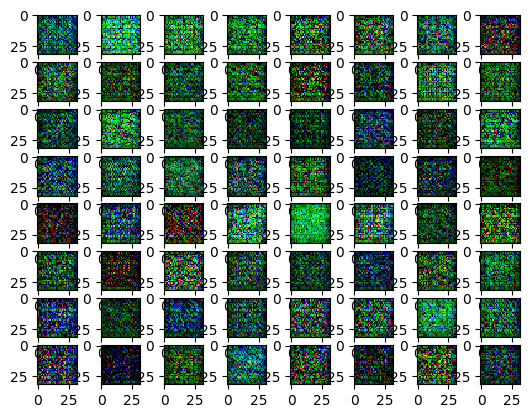

4096
Batch No.: 6 / 7 : GLoss= 0.6506 DLoss= 0.6688


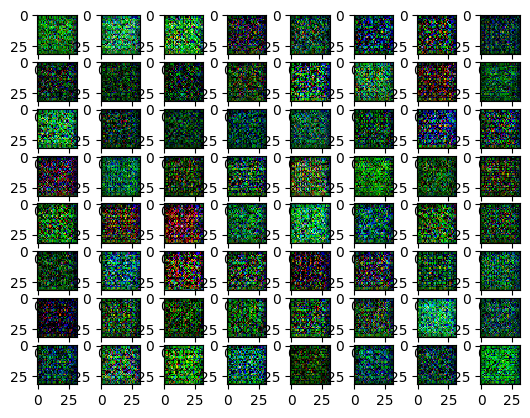

1603
Batch No.: 7 / 7 : GLoss= 0.6514 DLoss= 0.6675


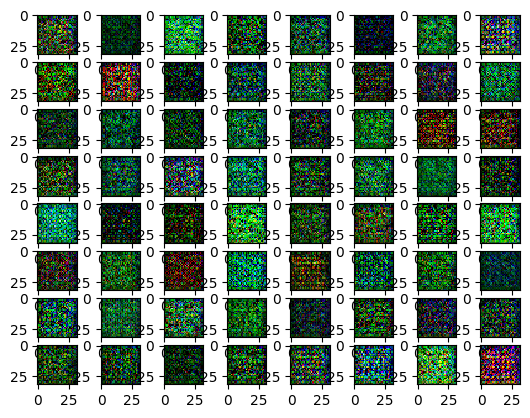

Epoch 3 / 5 :
4096
Batch No.: 1 / 7 : GLoss= 0.6622 DLoss= 0.6552


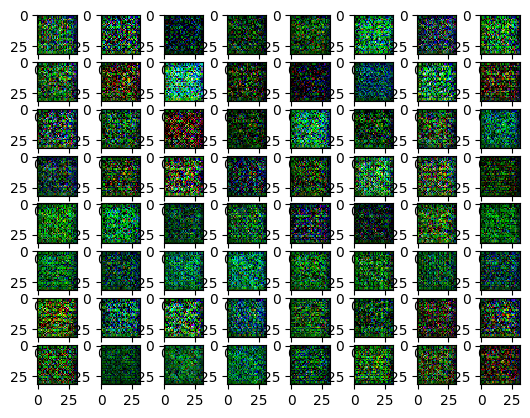

4096
Batch No.: 2 / 7 : GLoss= 0.6657 DLoss= 0.6443


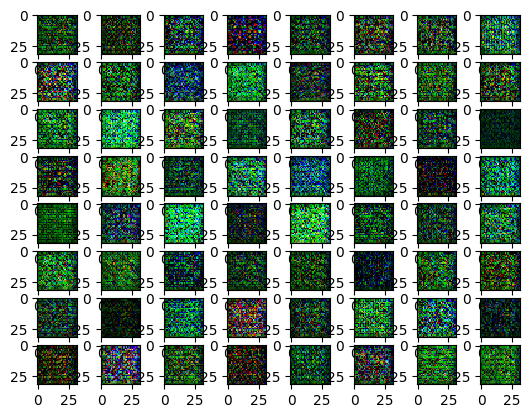

4096
Batch No.: 3 / 7 : GLoss= 0.6648 DLoss= 0.6364


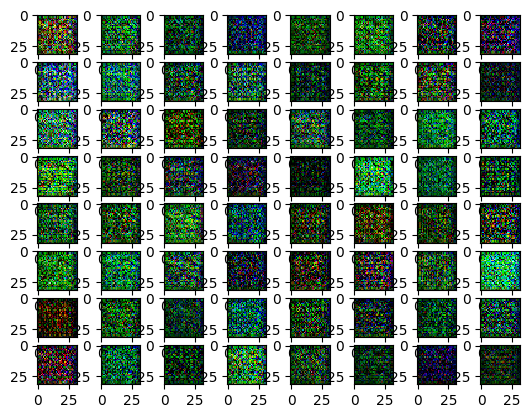

4096
Batch No.: 4 / 7 : GLoss= 0.6875 DLoss= 0.6282


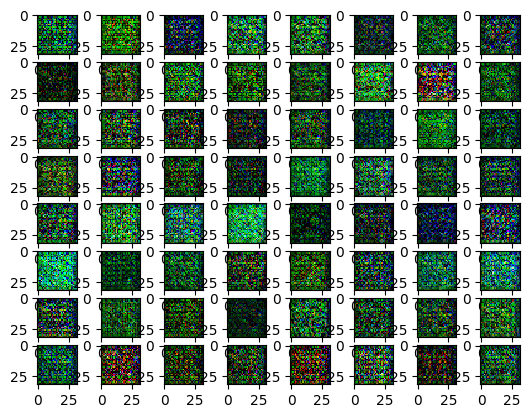

4096
Batch No.: 5 / 7 : GLoss= 0.6948 DLoss= 0.6193


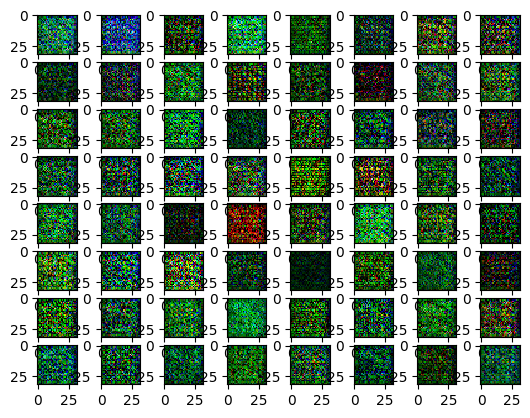

4096
Batch No.: 6 / 7 : GLoss= 0.7151 DLoss= 0.6166


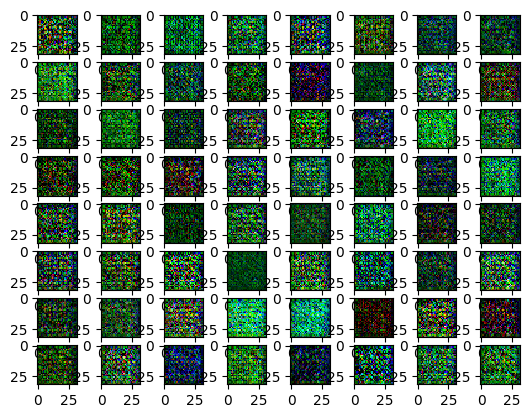

1603
Batch No.: 7 / 7 : GLoss= 0.7455 DLoss= 0.5861


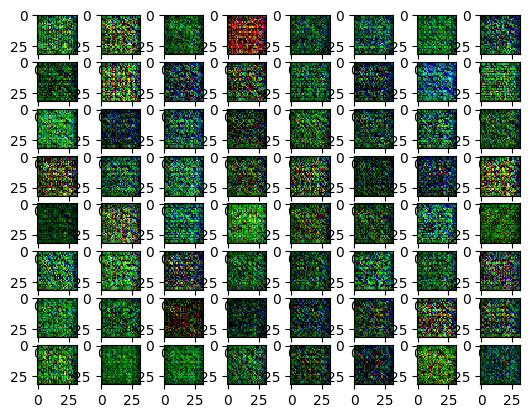

Epoch 4 / 5 :
4096
Batch No.: 1 / 7 : GLoss= 0.7858 DLoss= 0.5744


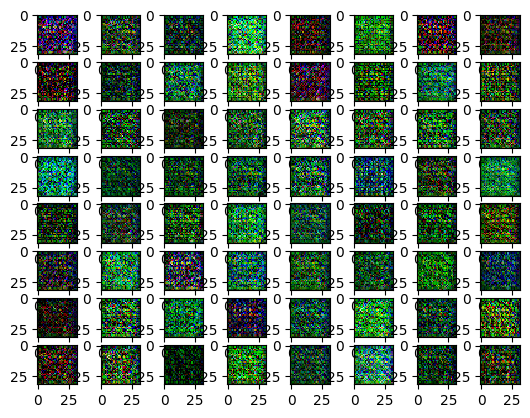

4096
Batch No.: 2 / 7 : GLoss= 0.8328 DLoss= 0.5505


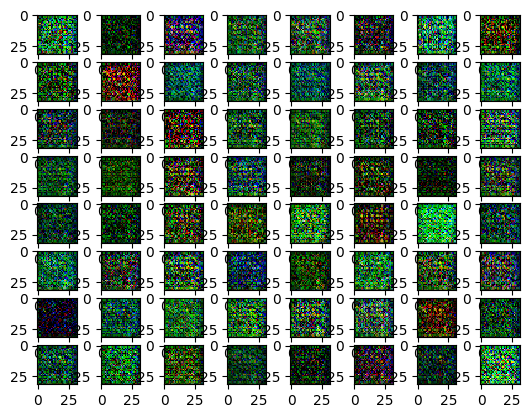

4096
Batch No.: 3 / 7 : GLoss= 0.8673 DLoss= 0.5344


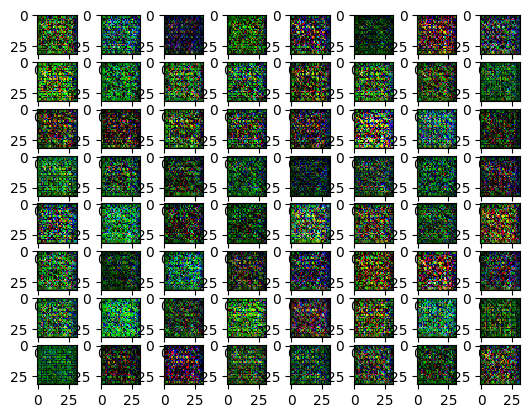

4096
Batch No.: 4 / 7 : GLoss= 0.8959 DLoss= 0.52


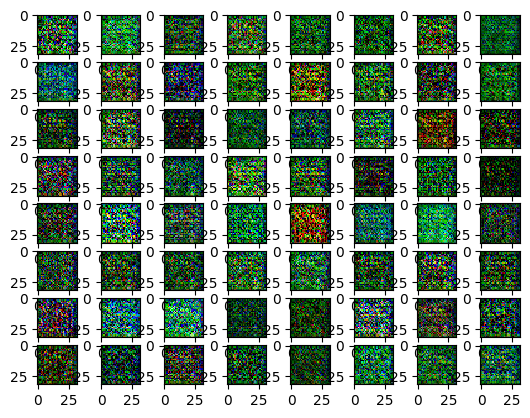

4096
Batch No.: 5 / 7 : GLoss= 0.9326 DLoss= 0.5003


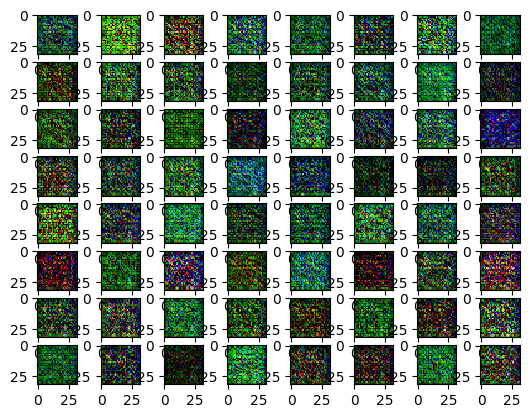

4096
Batch No.: 6 / 7 : GLoss= 0.9655 DLoss= 0.4846


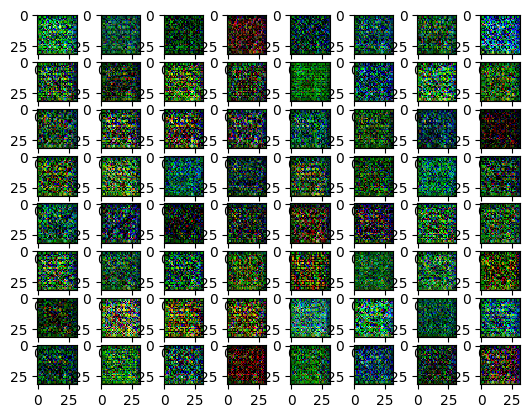

1603
Batch No.: 7 / 7 : GLoss= 0.9835 DLoss= 0.4774


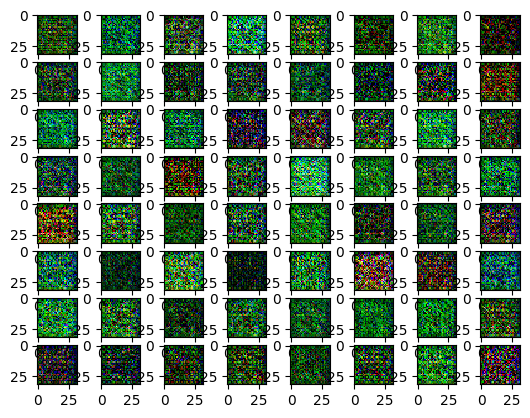

Epoch 5 / 5 :
4096
Batch No.: 1 / 7 : GLoss= 1.0179 DLoss= 0.4503


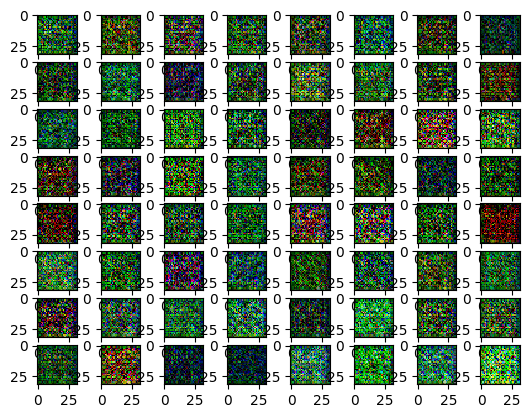

4096
Batch No.: 2 / 7 : GLoss= 1.0268 DLoss= 0.4397


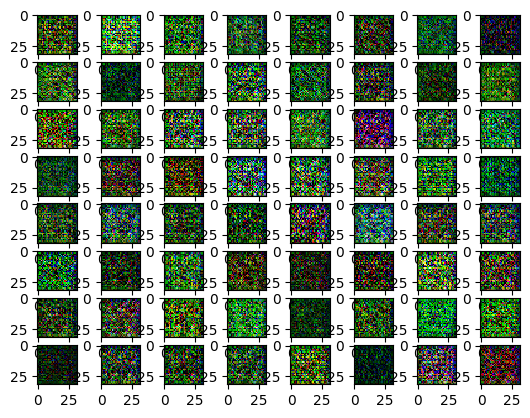

4096
Batch No.: 3 / 7 : GLoss= 1.0442 DLoss= 0.426


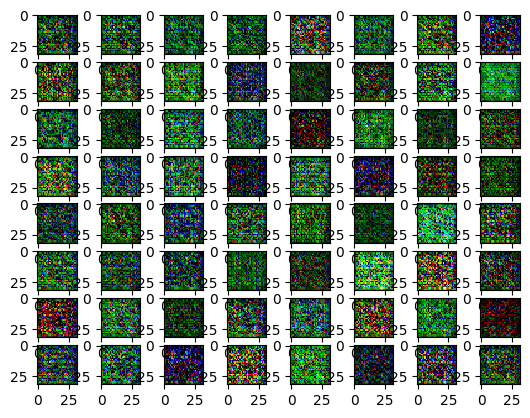

4096
Batch No.: 4 / 7 : GLoss= 1.0295 DLoss= 0.4279


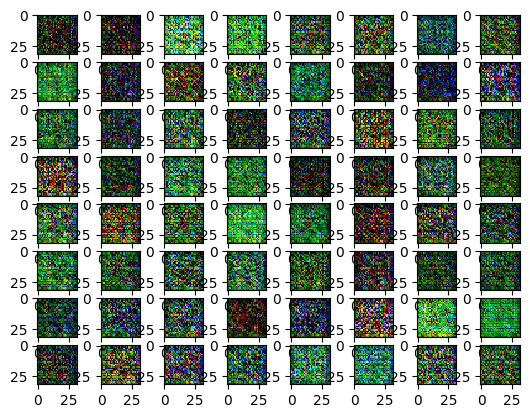

4096
Batch No.: 5 / 7 : GLoss= 1.0263 DLoss= 0.4155


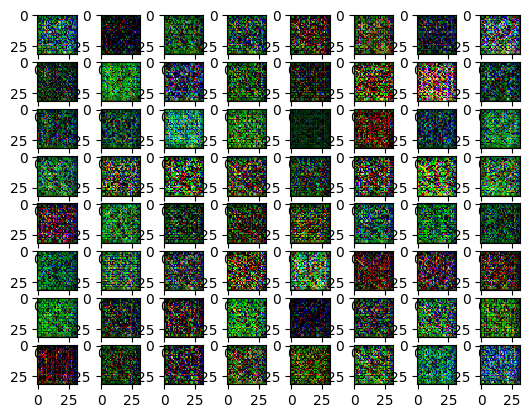

4096
Batch No.: 6 / 7 : GLoss= 1.0085 DLoss= 0.4216


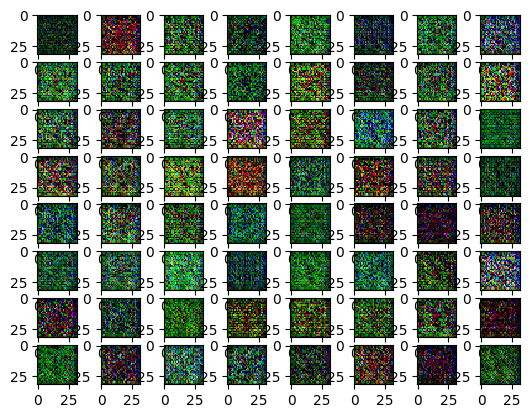

1603
Batch No.: 7 / 7 : GLoss= 0.9783 DLoss= 0.4282


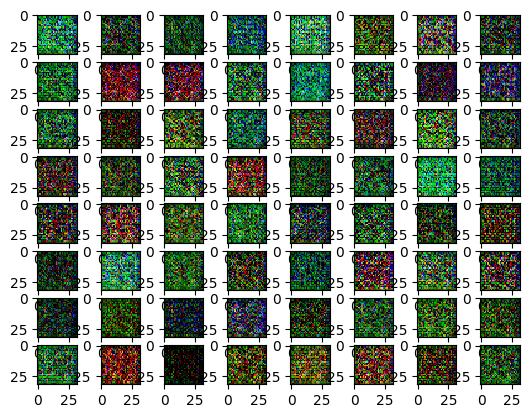

In [80]:
plt.figure(figsize=(10,5))
plt.title("Generated Images")
for e in range(5):
    print("Epoch",e+1,"/",5,":")
    train_one_epoch(plt)

In [81]:
torch.save(generator.state_dict(), 'g2.pth')
torch.save(discriminator.state_dict(), 'd2.pth')

In [82]:
class Animal10_text(Dataset):
    def __init__(self, input_list):
        self.transform = Compose([
            Resize((32,32),Image.BILINEAR), 
            ToTensor(),
        ])
        self.iml = input_list    
        self.translate = {"cane": "dog", 
                                      "cavallo": "horse", 
                                      "elefante": "elephant", 
                                      "farfalla": "butterfly", 
                                      "gallina": "chicken", 
                                      "gatto": "cat", 
                                      "mucca": "cow", 
                                      "ragno": "spider", 
                                      "pecora": "sheep", 
                                      "scoiattolo": "squirrel", 
                                      
                                      "dog": "cane", 
                                      "horse": "cavallo", 
                                      "elephant" : "elefante", 
                                      "butterfly": "farfalla", 
                                      "chicken": "gallina", 
                                      "cat": "gatto", 
                                      "cow": "mucca", 
                                      "spider": "ragno", 
                                      "sheep": "pecora",
                                      "squirrel": "scoiattolo"}
        
    def __len__(self):
        return len(self.iml)
        
    def __getitem__(self, text):
        imp = self.iml[idx]
        img = Image.open(imp).convert('RGB')
        parts = imp.split('/')
        extracted_part = parts[-2]
        return self.transform(img),self.translate[extracted_part]

In [83]:
dl[:10]

['/kaggle/input/animals10/raw-img/cavallo/OIP-mdvOxIWAyReAoEJcMk5z4wHaJ4.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-TPYKs3XId_sMgp_6LLA6JgDMEy.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-jlVRrokx7Vu1axi8OnTX2AHaE2.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-F4QVZ71QagiynDMnFNxJUAHaEK.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-UFtUZnXq0JHZo5R8UuF80wHaFj.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-irWuWeIWd3Hm3BWGd0OEsQHaGO.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-Y-hB14A3coI7TEgrEew0UAHaFj.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-KqeKmYfnRwKd89nLg8_zRAHaHb.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-s40xdXSQY099gt1hLGlzAwHaFP.jpeg',
 '/kaggle/input/animals10/raw-img/cavallo/OIP-4k_sWoJ4_9-G1f0emDBVtwHaE6.jpeg']

In [88]:
def get_data(inp):
    # dog, horse, elephant, butterfly, chicken, cat, cow, spider, sheep, squirrel
    inp = "dog"
    translate = {"cane": "dog", 
                                          "cavallo": "horse", 
                                          "elefante": "elephant", 
                                          "farfalla": "butterfly", 
                                          "gallina": "chicken", 
                                          "gatto": "cat", 
                                          "mucca": "cow", 
                                          "ragno": "spider", 
                                          "pecora": "sheep", 
                                          "scoiattolo": "squirrel", 

                                          "dog": "cane", 
                                          "horse": "cavallo", 
                                          "elephant" : "elefante", 
                                          "butterfly": "farfalla", 
                                          "chicken": "gallina", 
                                          "cat": "gatto", 
                                          "cow": "mucca", 
                                          "spider": "ragno", 
                                          "sheep": "pecora",
                                          "squirrel": "scoiattolo"}
    inppath = translate[inp]
    inppath = "/kaggle/input/animals10/raw-img/" + inppath
    inppath

    dl2 = []
    for dirname, _, filenames in os.walk(inppath):
        for filename in filenames:
            dl2+=[os.path.join(dirname, filename)]
    # dl2
    newDS = Animal10(dl2)
    newbs = 32
    newDL = DataLoader(dataset=trainDS, batch_size=newbs, shuffle=True)
    return newDL

In [89]:
def new_eval(plt, dloader):
    e1.eval()
    e2.eval()
    generator.eval()
    for i,(imgs,_) in enumerate(dloader):            
        x=torch.reshape(imgs,shape=(-1,1024))
        x=x.to(device)

        latente1=e1(x)
        latente2=e2(latente1)
                    
        noise_vectors = latente2.view(imgs.shape[0], 300)   
        
        print(noise_vectors.shape)
        
        fake_images=generator(noise_vectors)
        
        print(fake_images.shape)
        
        if True:
            for j in range(16):
                plt.subplot(4,4,j+1)
                plt.imshow(torch.permute(fake_images[j],(1,2,0)).detach().cpu(),interpolation='nearest')
                plt.show()
        break;


In [92]:
# dog, horse, elephant, butterfly, chicken, cat, cow, spider, sheep, squirrel
inp = "horse"
data = get_data(inp)

torch.Size([32, 300])
torch.Size([32, 3, 32, 32])


/tmp/ipykernel_34/1461124613.py:22: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,4,j+1)


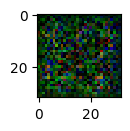

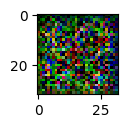

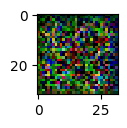

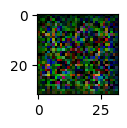

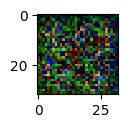

...

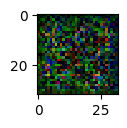

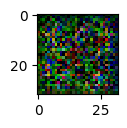

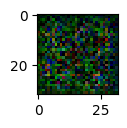

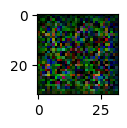

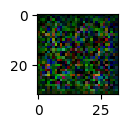

In [93]:
plt.figure(figsize=(10,5))
plt.title("Generated Images")
for e in range(1):
    new_eval(plt, data)

Epoch 1 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.1576 DLoss= 0.3699


/tmp/ipykernel_34/37407091.py:46: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(8,8,j+1)


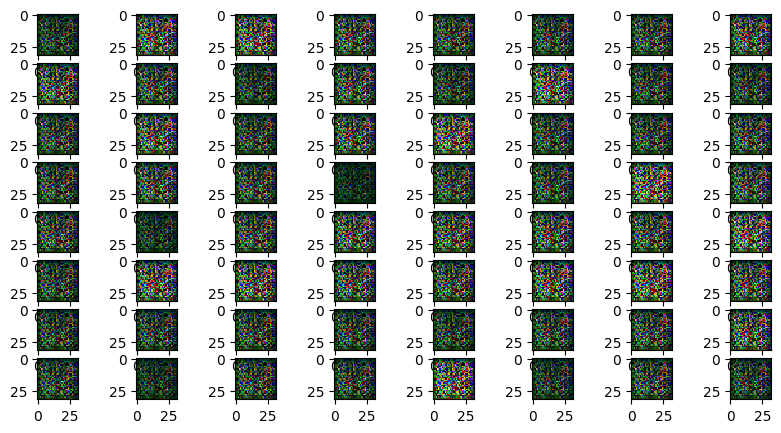

4096
Batch No.: 2 / 7 : GLoss= 1.0836 DLoss= 0.3818


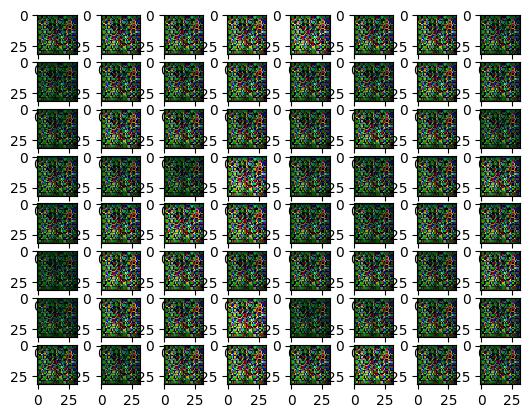

4096
Batch No.: 3 / 7 : GLoss= 0.92 DLoss= 0.422


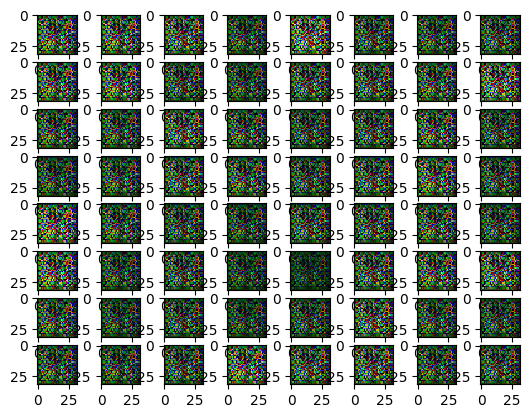

4096
Batch No.: 4 / 7 : GLoss= 0.7268 DLoss= 0.5002


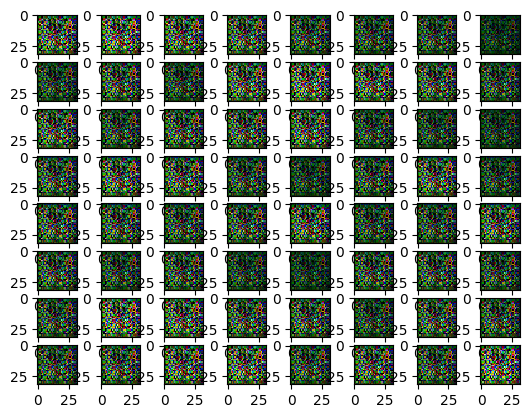

4096
Batch No.: 5 / 7 : GLoss= 0.5846 DLoss= 0.5744


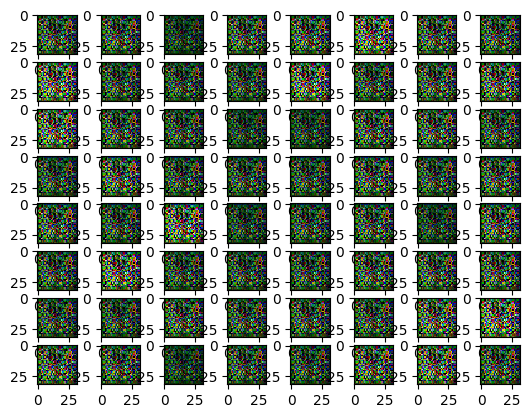

4096
Batch No.: 6 / 7 : GLoss= 0.5261 DLoss= 0.6218


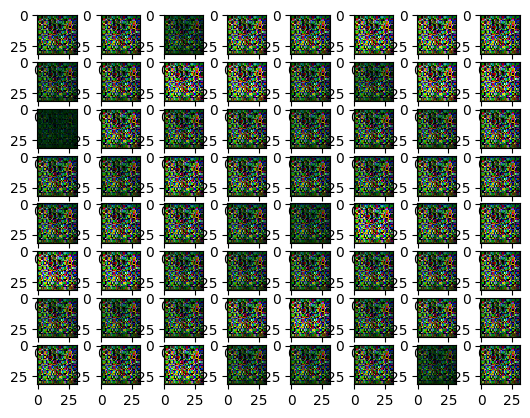

1603
Batch No.: 7 / 7 : GLoss= 0.5185 DLoss= 0.6238


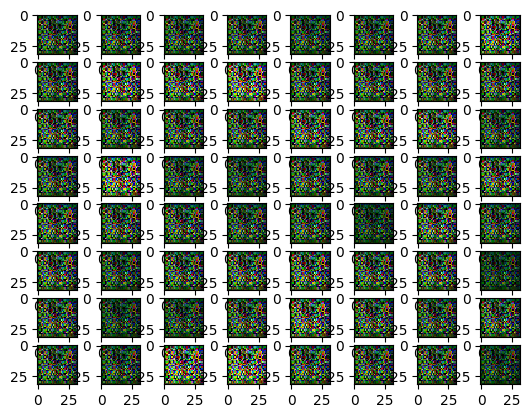

Epoch 2 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 0.5527 DLoss= 0.5948


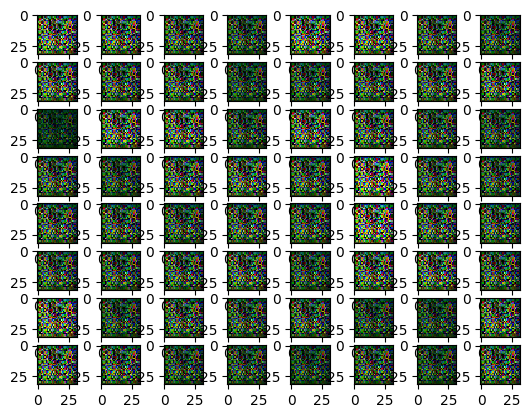

4096
Batch No.: 2 / 7 : GLoss= 0.6071 DLoss= 0.5585


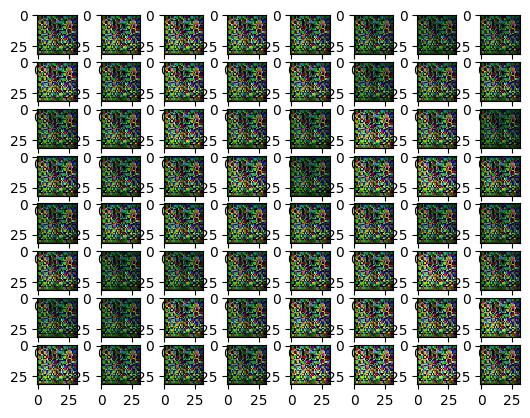

4096
Batch No.: 3 / 7 : GLoss= 0.6395 DLoss= 0.5466


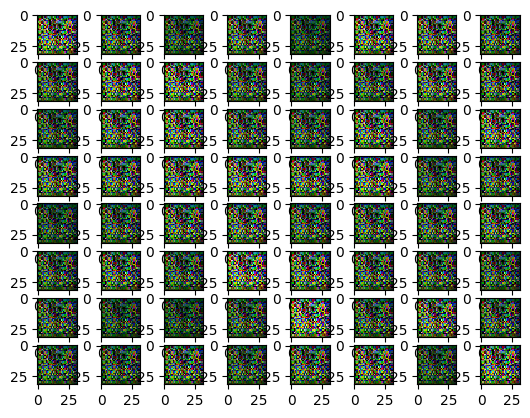

4096
Batch No.: 4 / 7 : GLoss= 0.6935 DLoss= 0.5212


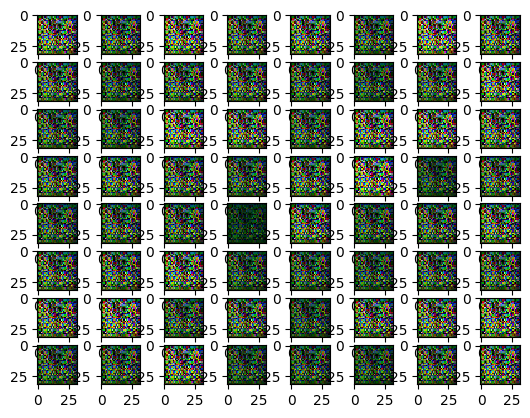

4096
Batch No.: 5 / 7 : GLoss= 0.7509 DLoss= 0.4963


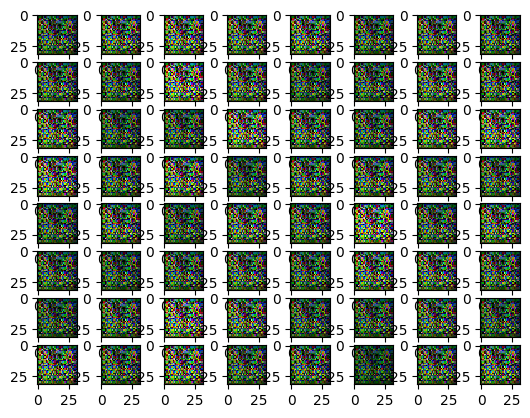

4096
Batch No.: 6 / 7 : GLoss= 0.8229 DLoss= 0.4665


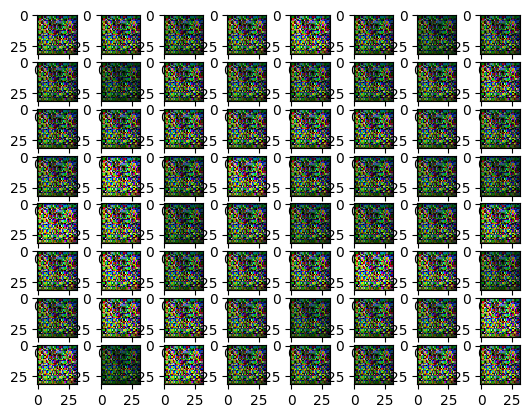

1603
Batch No.: 7 / 7 : GLoss= 0.9221 DLoss= 0.4432


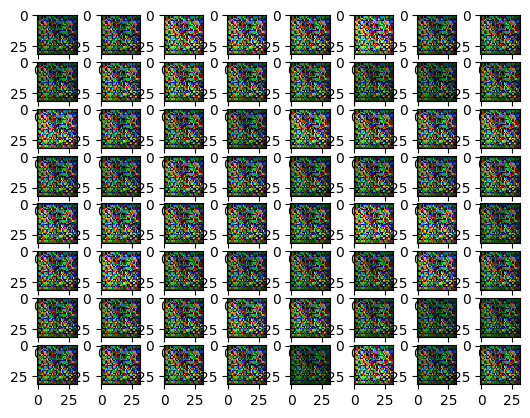

Epoch 3 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 0.9782 DLoss= 0.4085


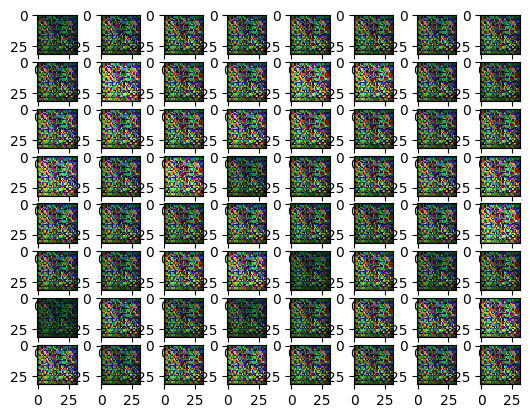

4096
Batch No.: 2 / 7 : GLoss= 1.0042 DLoss= 0.4014


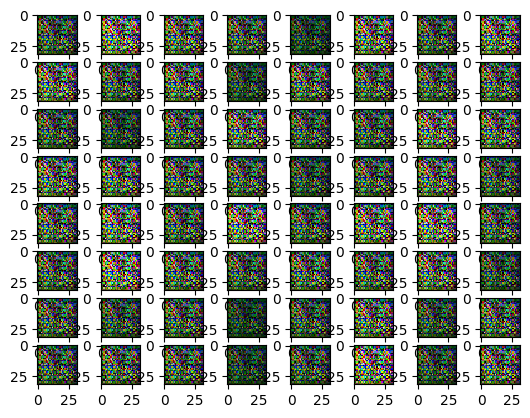

4096
Batch No.: 3 / 7 : GLoss= 1.0142 DLoss= 0.3985


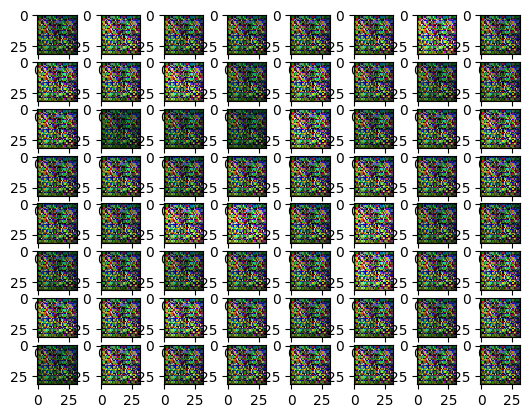

4096
Batch No.: 4 / 7 : GLoss= 0.964 DLoss= 0.4097


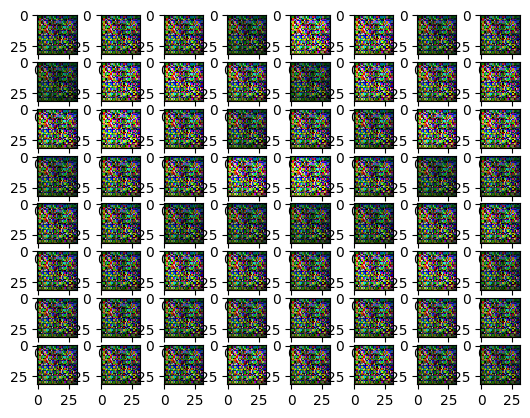

4096
Batch No.: 5 / 7 : GLoss= 0.9138 DLoss= 0.4205


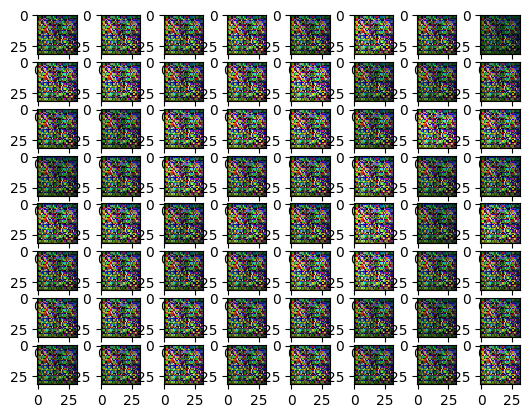

4096
Batch No.: 6 / 7 : GLoss= 0.9705 DLoss= 0.3973


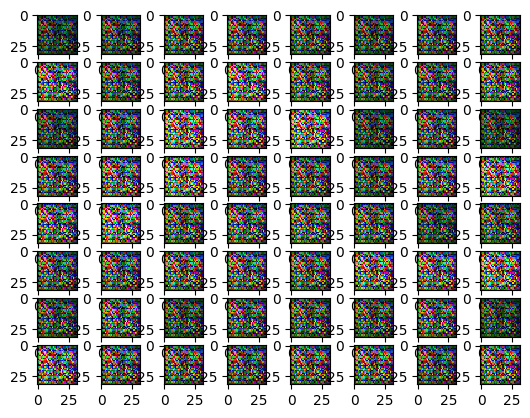

1603
Batch No.: 7 / 7 : GLoss= 1.0252 DLoss= 0.365


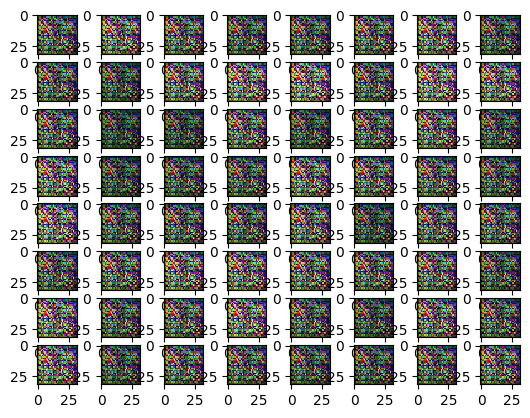

Epoch 4 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.0532 DLoss= 0.3681


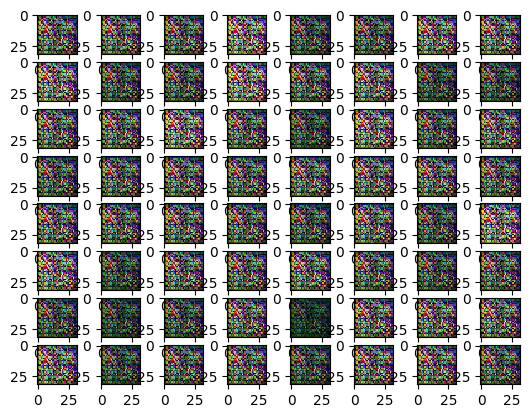

4096
Batch No.: 2 / 7 : GLoss= 1.0818 DLoss= 0.3519


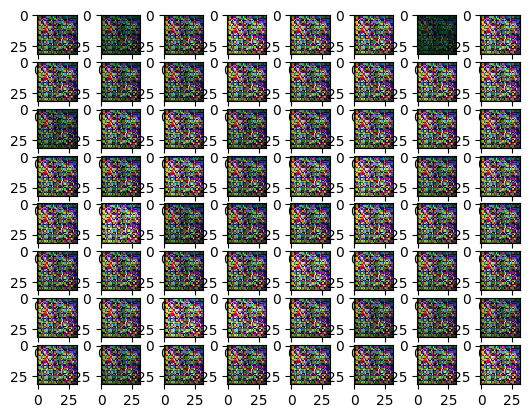

4096
Batch No.: 3 / 7 : GLoss= 1.1285 DLoss= 0.3388


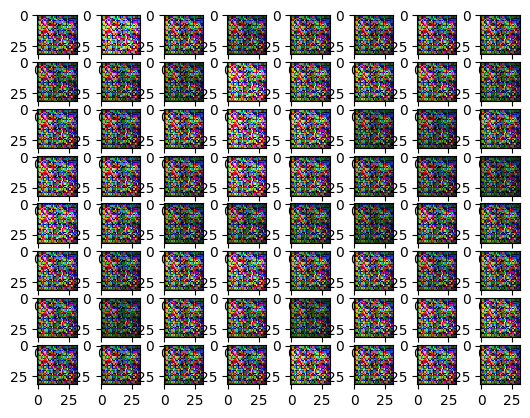

4096
Batch No.: 4 / 7 : GLoss= 1.133 DLoss= 0.3367


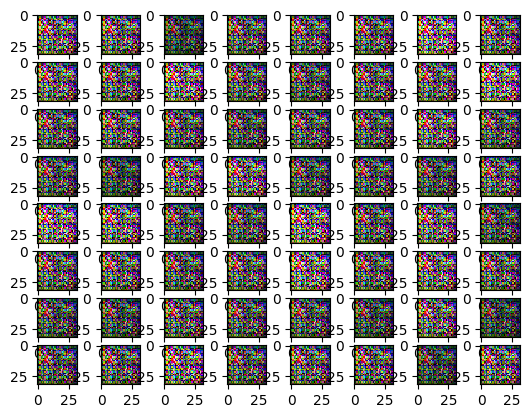

4096
Batch No.: 5 / 7 : GLoss= 1.1653 DLoss= 0.3197


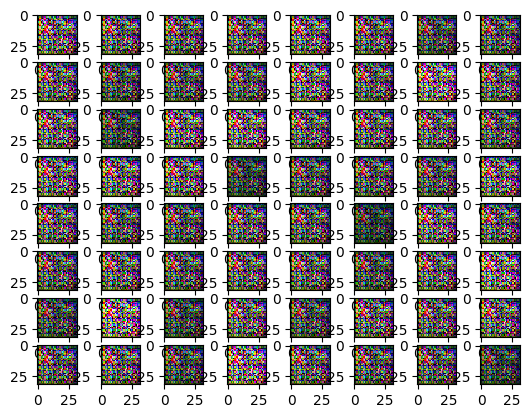

4096
Batch No.: 6 / 7 : GLoss= 1.1653 DLoss= 0.3235


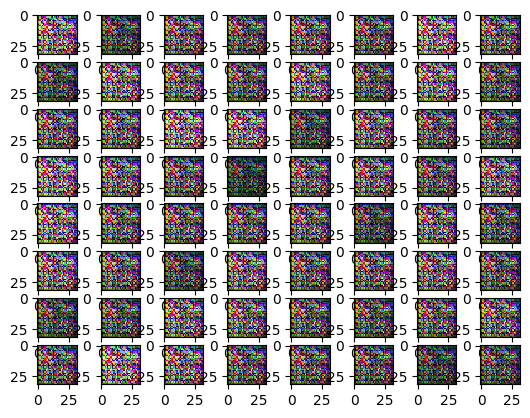

1603
Batch No.: 7 / 7 : GLoss= 1.1194 DLoss= 0.3343


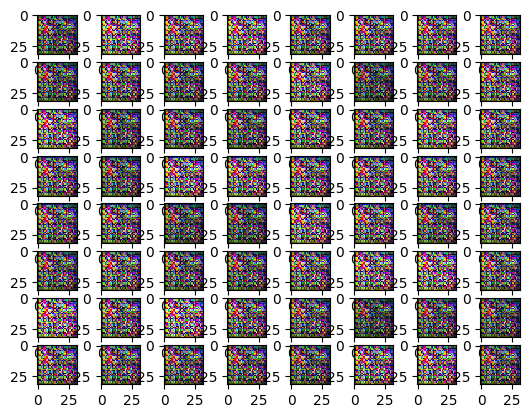

Epoch 5 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 0.9173 DLoss= 0.3974


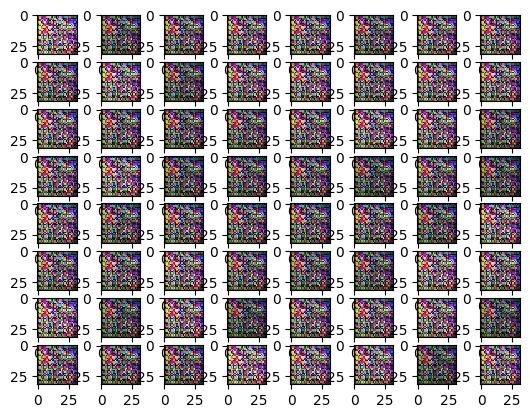

4096
Batch No.: 2 / 7 : GLoss= 0.7674 DLoss= 0.4492


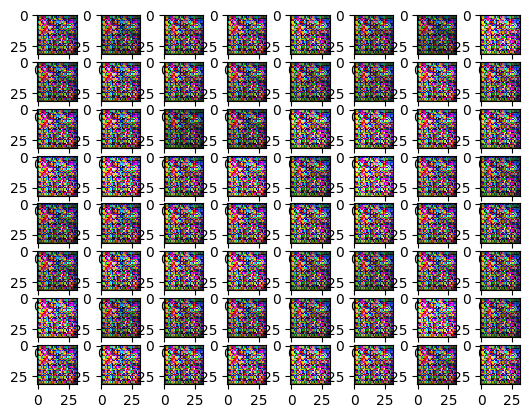

4096
Batch No.: 3 / 7 : GLoss= 0.7154 DLoss= 0.4767


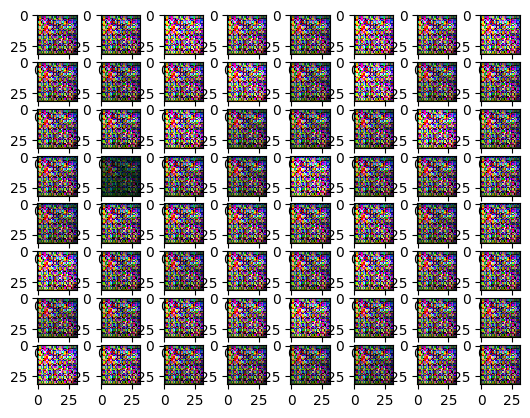

4096
Batch No.: 4 / 7 : GLoss= 0.7706 DLoss= 0.4541


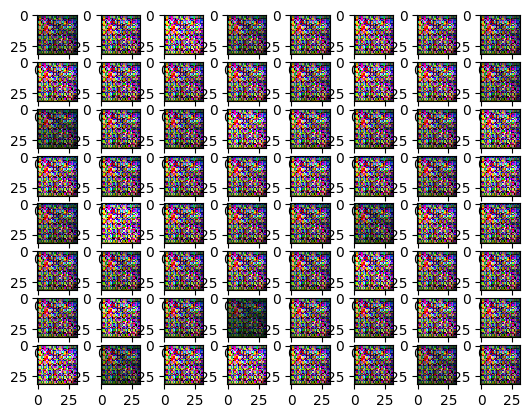

4096
Batch No.: 5 / 7 : GLoss= 0.9759 DLoss= 0.3684


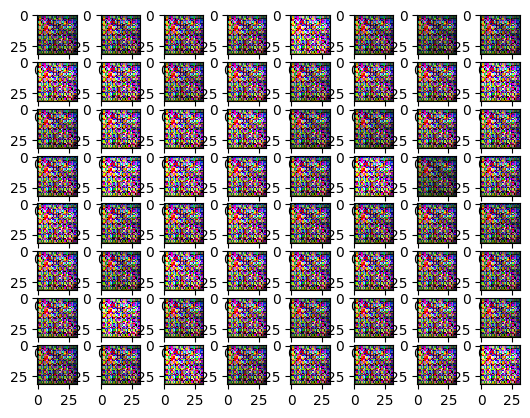

4096
Batch No.: 6 / 7 : GLoss= 1.2368 DLoss= 0.3175


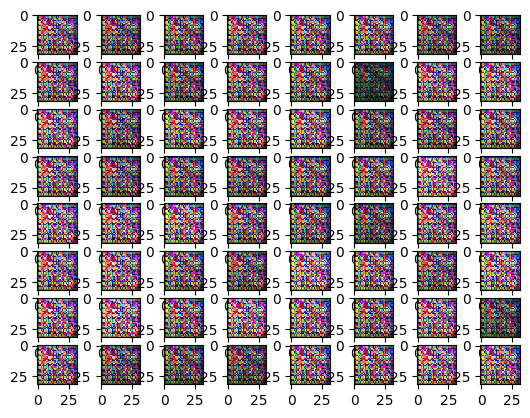

1603
Batch No.: 7 / 7 : GLoss= 1.3719 DLoss= 0.2905


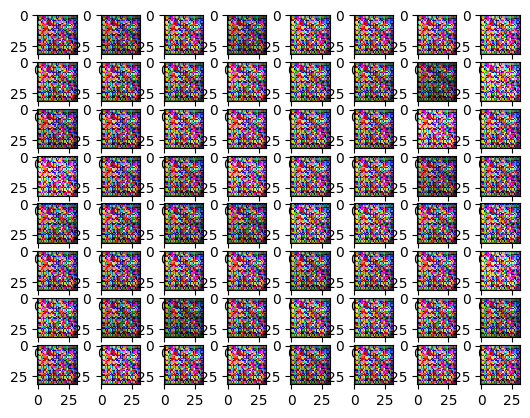

Epoch 6 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.3507 DLoss= 0.3039


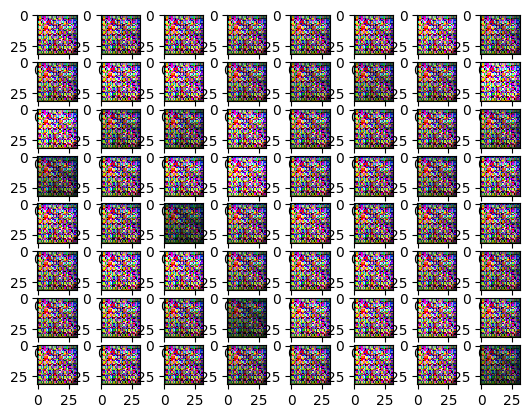

4096
Batch No.: 2 / 7 : GLoss= 1.1756 DLoss= 0.3317


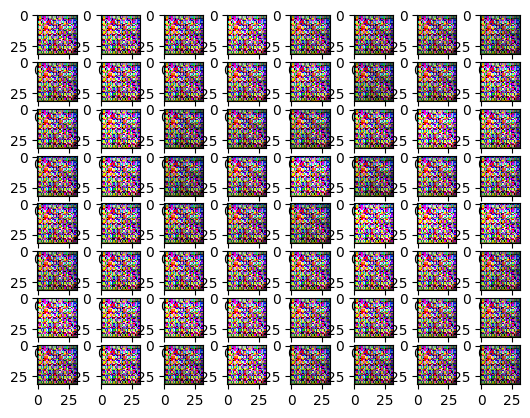

4096
Batch No.: 3 / 7 : GLoss= 0.9993 DLoss= 0.3803


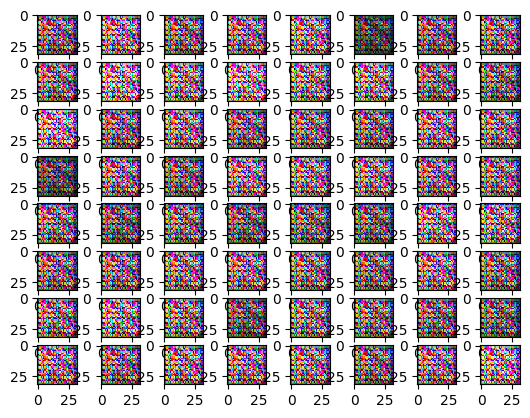

4096
Batch No.: 4 / 7 : GLoss= 0.8858 DLoss= 0.4223


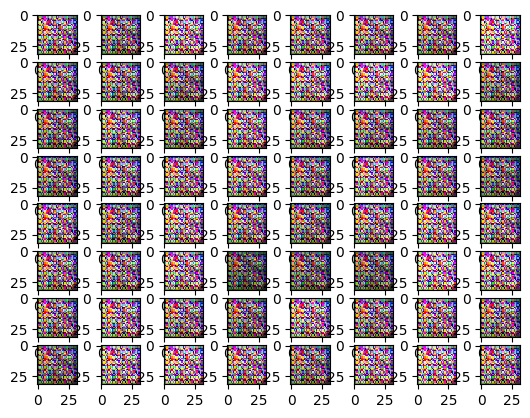

4096
Batch No.: 5 / 7 : GLoss= 0.8587 DLoss= 0.4328


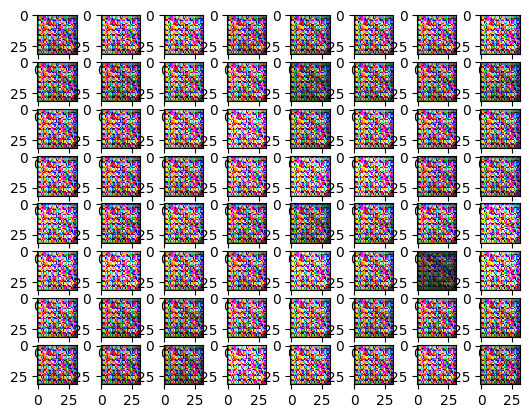

4096
Batch No.: 6 / 7 : GLoss= 0.9163 DLoss= 0.4252


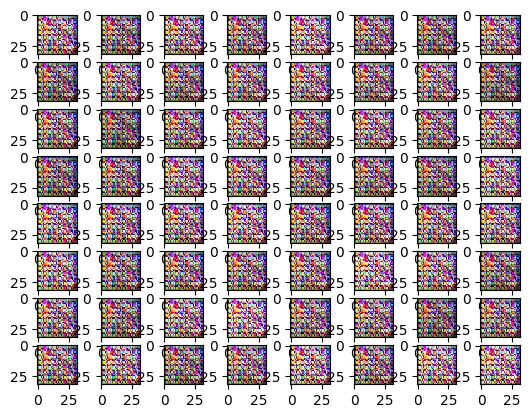

1603
Batch No.: 7 / 7 : GLoss= 0.9971 DLoss= 0.3952


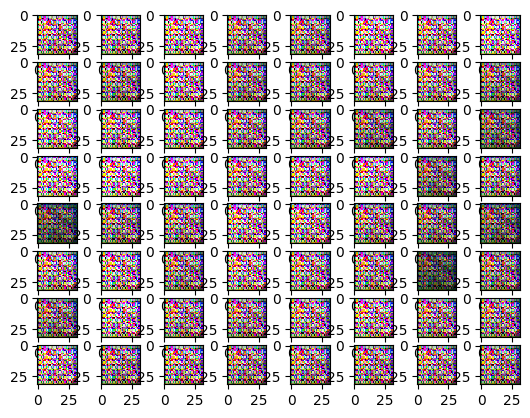

Epoch 7 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.0609 DLoss= 0.379


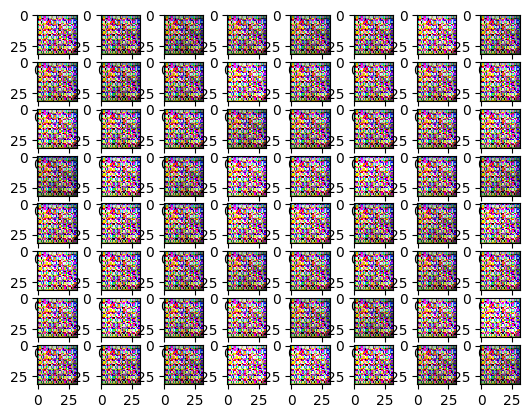

4096
Batch No.: 2 / 7 : GLoss= 1.0793 DLoss= 0.3879


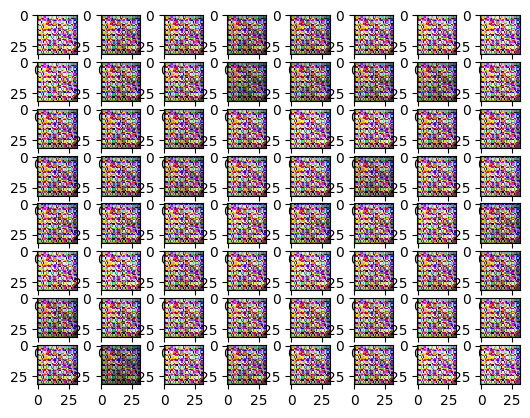

4096
Batch No.: 3 / 7 : GLoss= 1.1075 DLoss= 0.3827


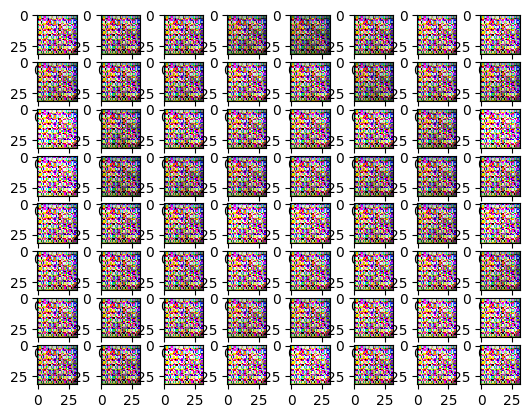

4096
Batch No.: 4 / 7 : GLoss= 1.1797 DLoss= 0.3695


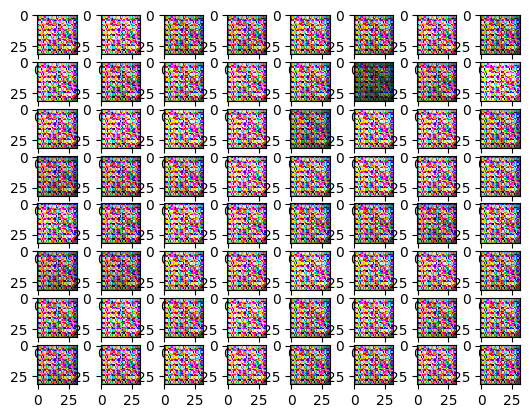

4096
Batch No.: 5 / 7 : GLoss= 1.2368 DLoss= 0.3543


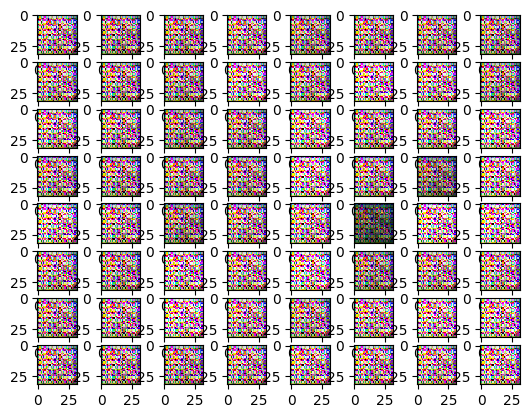

4096
Batch No.: 6 / 7 : GLoss= 1.1864 DLoss= 0.358


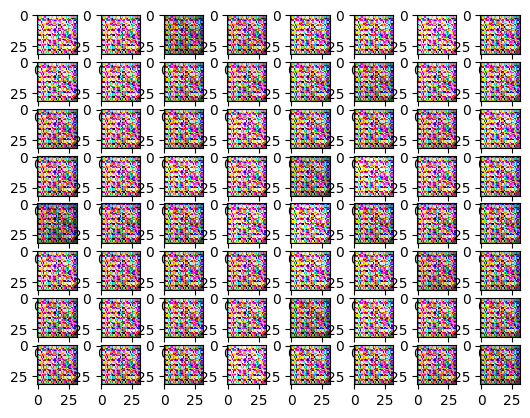

1603
Batch No.: 7 / 7 : GLoss= 1.0721 DLoss= 0.3862


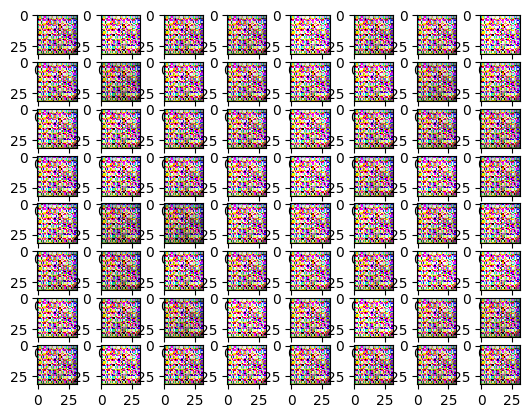

Epoch 8 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 0.998 DLoss= 0.4176


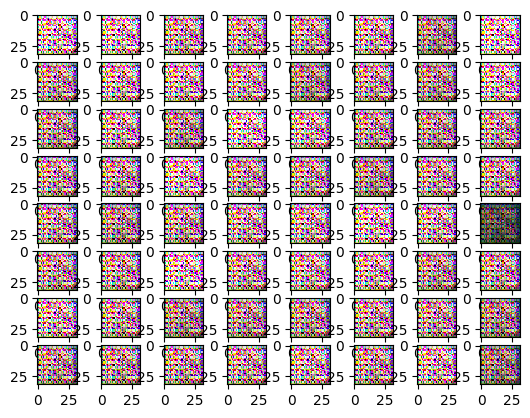

4096
Batch No.: 2 / 7 : GLoss= 1.0397 DLoss= 0.4113


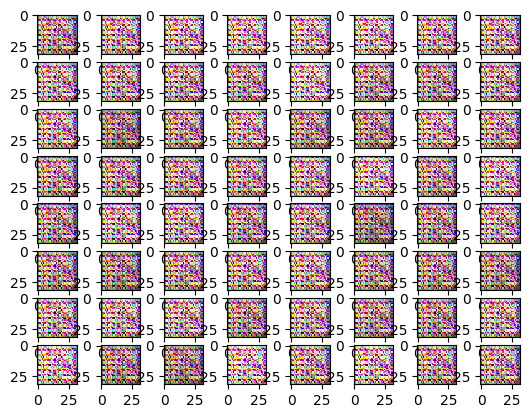

4096
Batch No.: 3 / 7 : GLoss= 1.1363 DLoss= 0.3858


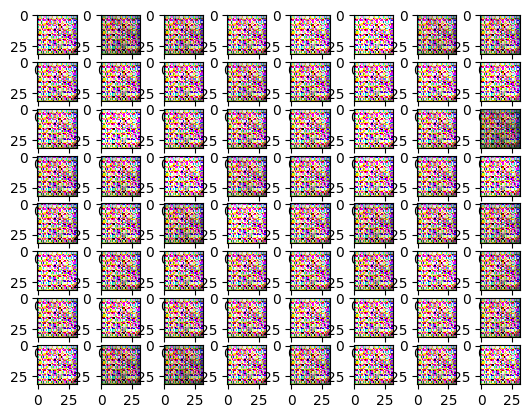

4096
Batch No.: 4 / 7 : GLoss= 1.1903 DLoss= 0.3676


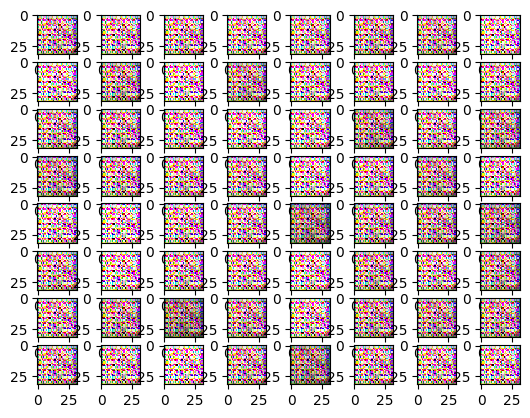

4096
Batch No.: 5 / 7 : GLoss= 1.2812 DLoss= 0.3483


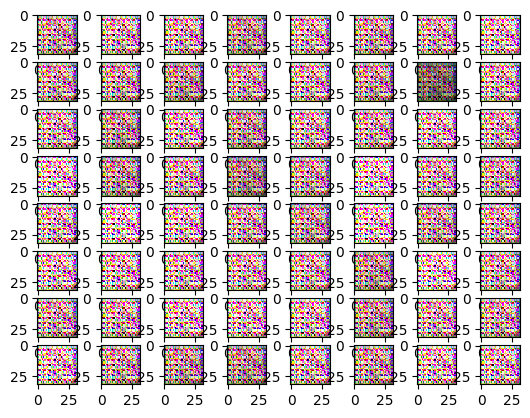

4096
Batch No.: 6 / 7 : GLoss= 1.3744 DLoss= 0.3417


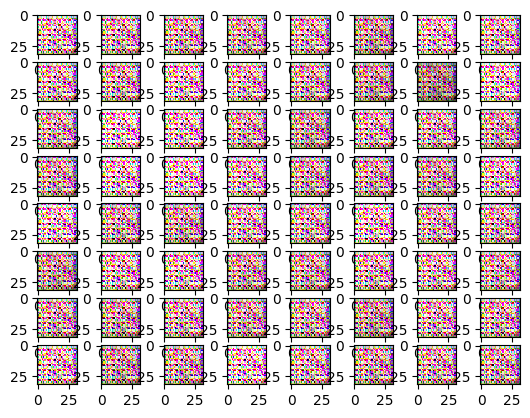

1603
Batch No.: 7 / 7 : GLoss= 1.4287 DLoss= 0.3353


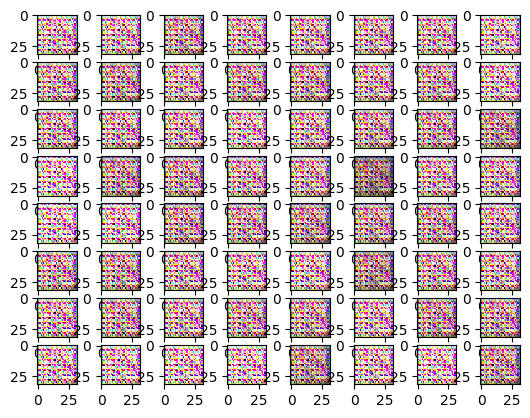

Epoch 9 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.3507 DLoss= 0.3451


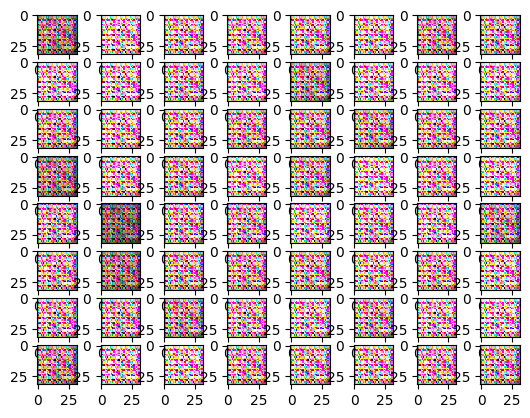

4096
Batch No.: 2 / 7 : GLoss= 1.2041 DLoss= 0.3603


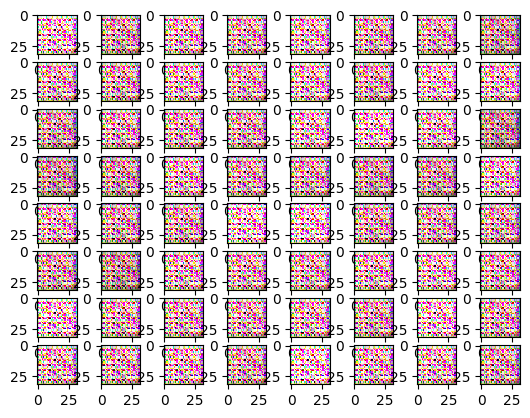

4096
Batch No.: 3 / 7 : GLoss= 1.1093 DLoss= 0.3775


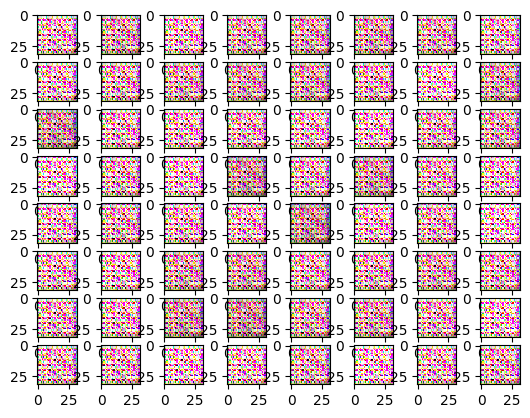

4096
Batch No.: 4 / 7 : GLoss= 1.0494 DLoss= 0.3909


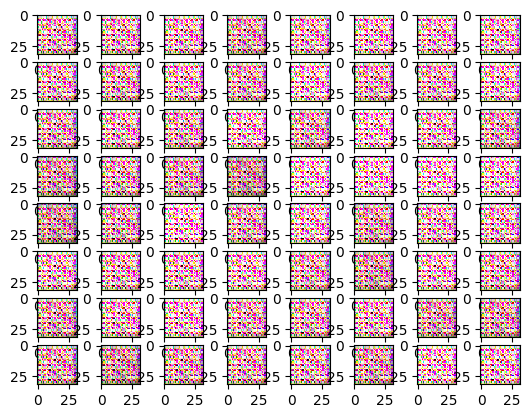

4096
Batch No.: 5 / 7 : GLoss= 1.0676 DLoss= 0.3955


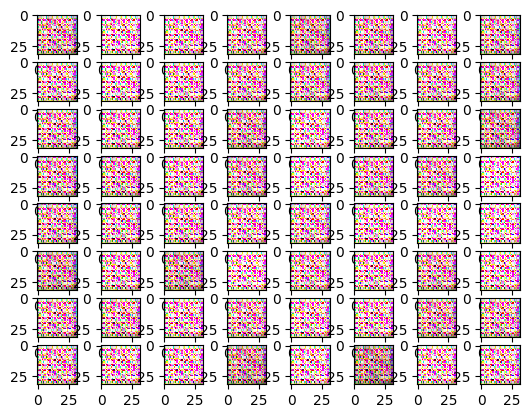

4096
Batch No.: 6 / 7 : GLoss= 1.119 DLoss= 0.3758


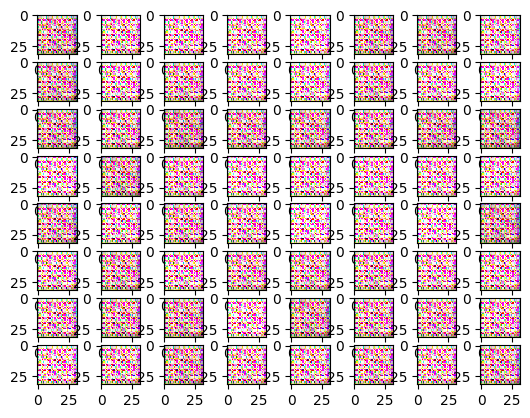

1603
Batch No.: 7 / 7 : GLoss= 1.1792 DLoss= 0.3695


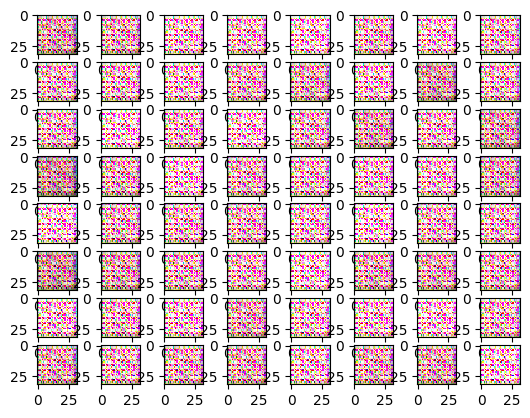

Epoch 10 / 10 :
4096
Batch No.: 1 / 7 : GLoss= 1.3051 DLoss= 0.3411


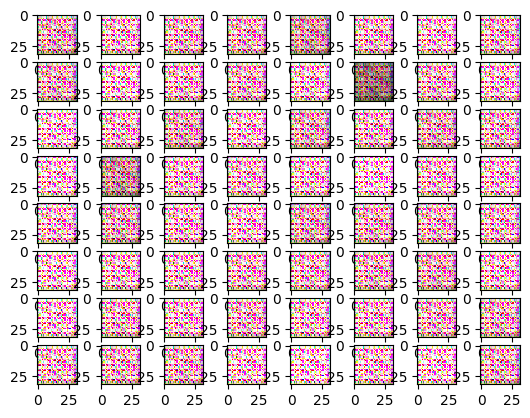

4096
Batch No.: 2 / 7 : GLoss= 1.395 DLoss= 0.3163


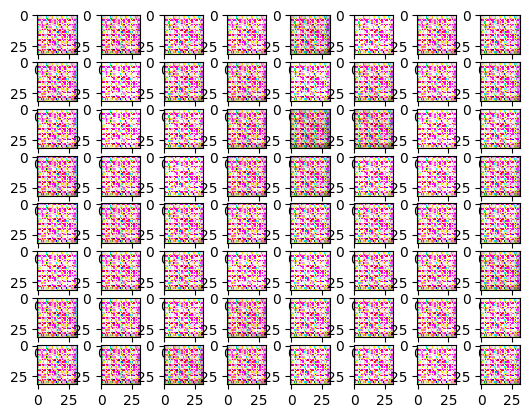

4096
Batch No.: 3 / 7 : GLoss= 1.4609 DLoss= 0.3085


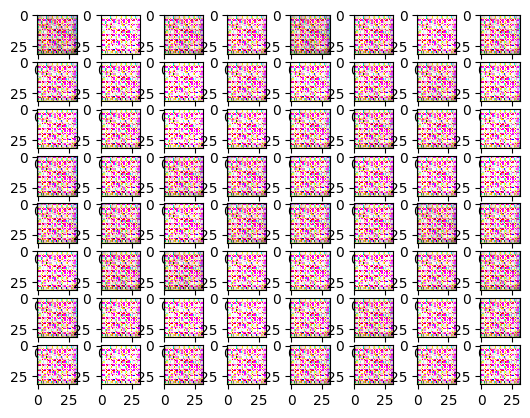

4096
Batch No.: 4 / 7 : GLoss= 1.4812 DLoss= 0.31


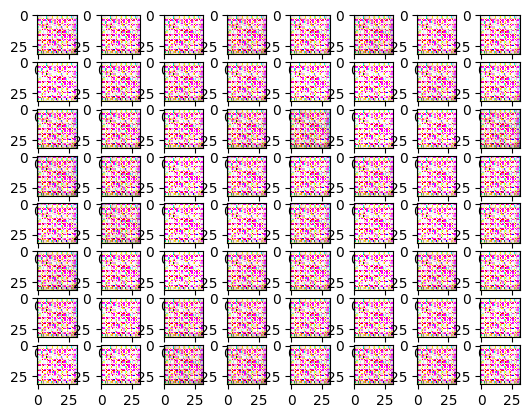

4096
Batch No.: 5 / 7 : GLoss= 1.4548 DLoss= 0.311


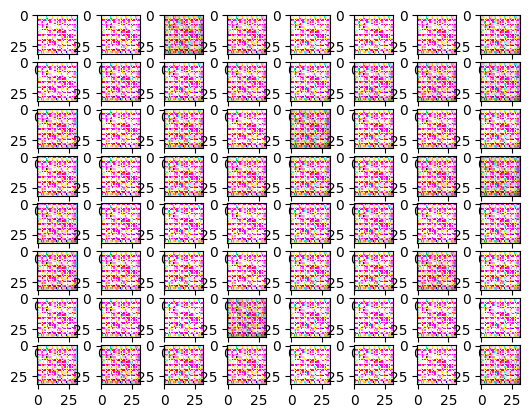

4096
Batch No.: 6 / 7 : GLoss= 1.4112 DLoss= 0.3142


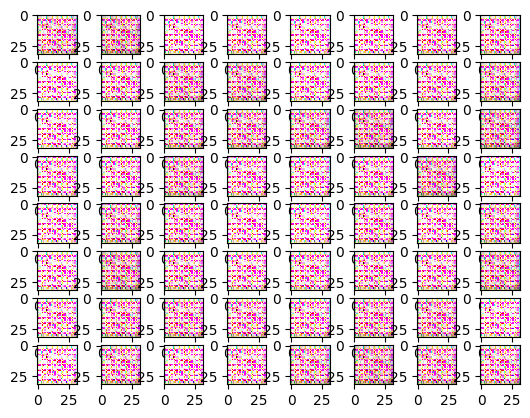

1603
Batch No.: 7 / 7 : GLoss= 1.3978 DLoss= 0.3024


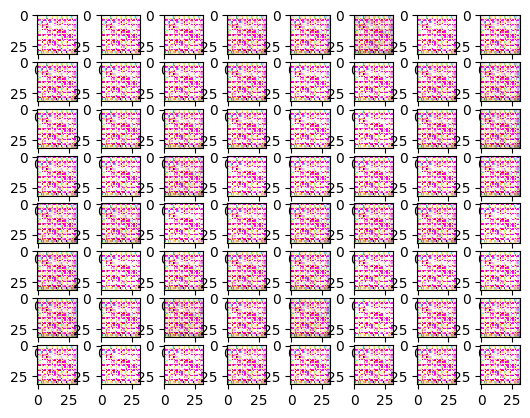

In [95]:
plt.figure(figsize=(10,5))
plt.title("Generated Images")
for e in range(10):
    print("Epoch",e+1,"/",10,":")
    train_one_epoch(plt)

In [96]:
torch.save(generator.state_dict(), 'g2.pth')
torch.save(discriminator.state_dict(), 'd2.pth')

torch.Size([32, 300])
torch.Size([32, 3, 32, 32])


/tmp/ipykernel_34/1461124613.py:22: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4,4,j+1)


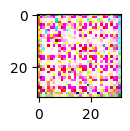

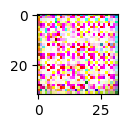

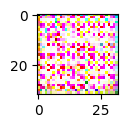

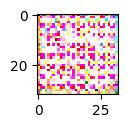

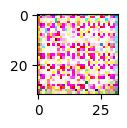

...

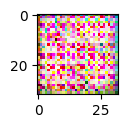

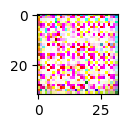

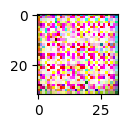

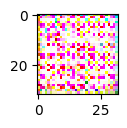

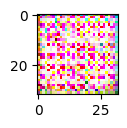

In [99]:
# dog, horse, elephant, butterfly, chicken, cat, cow, spider, sheep, squirrel
inp = "horse"
data = get_data(inp)
plt.figure(figsize=(10,5))
plt.title("Generated Images")
for e in range(1):
    new_eval(plt, data)